# Clustering & Spatial Domain Detection

Identify transcriptionally distinct clusters and map them back to tissue morphology. Discover spatial domains that correspond to known breast cancer histological regions.

In [1]:
# IMPORTS & PATHS 

from __future__ import annotations
from pathlib import Path
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import tempfile

# Workaround for Windows Store Python + numba caching: use a writable cache dir
os.environ.setdefault('NUMBA_CACHE_DIR', str(Path(tempfile.gettempdir()) / 'numba_cache'))
Path(os.environ['NUMBA_CACHE_DIR']).mkdir(parents=True, exist_ok=True)

import scanpy as sc
import squidpy as sq

# Make saved PNGs readable in viewers (no transparency / white background)
sc.settings.set_figure_params(dpi=120, facecolor='white', transparent=False)
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['savefig.facecolor'] = 'white'
plt.rcParams['savefig.transparent'] = False


sc.settings.verbosity = 3

# Project Root
cwd = Path.cwd().resolve()
if (cwd / 'README.md').exists() and (cwd / 'data').exists():
    project_root = cwd
elif (cwd.parent / 'README.md').exists() and (cwd.parent / 'data').exists():
    project_root = cwd.parent
else:
    raise RuntimeError(f'Cannot locate project root from cwd={cwd}.')

raw_dir       = project_root / 'data' / 'raw'   / 'Visium_Human_Breast_Cancer'
processed_dir = project_root / 'data' / 'processed'
fig_qc_dir    = project_root / 'figures' / 'qc'
fig_sp_dir    = project_root / 'figures' / 'spatial'

for d in [processed_dir, fig_qc_dir, fig_sp_dir]:
    d.mkdir(parents=True, exist_ok=True)

sc.settings.figdir = str(fig_qc_dir)

print(f"Scanpy  : {sc.__version__}")
print(f"Squidpy : {sq.__version__}")
print(f"Raw dir : {raw_dir}")

Scanpy  : 1.12
Squidpy : 1.8.1
Raw dir : C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\data\raw\Visium_Human_Breast_Cancer


In [2]:
# LOAD PREPROCESSED ADATA 
adata = sc.read_h5ad(processed_dir / 'adata_preprocessed.h5ad')
print(adata)
print(f"Spots : {adata.n_obs:,}  Genes : {adata.n_vars:,}")
print(f"UMAP  : {adata.obsm['X_umap'].shape}")
print(f"Neighbors computed : {'neighbors' in adata.uns}")

AnnData object with n_obs × n_vars = 4869 × 21349
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'neighbors', 'pca', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'
Spots : 4,869  Genes : 21,349
UMAP  : (4869, 2)
Neighbors computed : True


In [3]:
# LEIDEN CLUSTERING (MULTIPLE RESOLUTIONS) 
# We test 4 resolutions to find the best biological granularity
# Low  res (0.3) → fewer, broader clusters
# High res (1.0) → more, finer clusters

resolutions = [0.3, 0.5, 0.6, 1.0]

for res in resolutions:
    sc.tl.leiden(adata, resolution=res,
                 key_added=f'leiden_{res}',
                 random_state=42)
    n_cl = adata.obs[f'leiden_{res}'].nunique()
    print(f"  res={res:.1f}  →  {n_cl} clusters")

running Leiden clustering
    finished: found 6 clusters and added
    'leiden_0.3', the cluster labels (adata.obs, categorical) (0:00:00)
  res=0.3  →  6 clusters
running Leiden clustering
    finished: found 9 clusters and added
    'leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:00)
  res=0.5  →  9 clusters
running Leiden clustering
    finished: found 10 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:00)
  res=0.6  →  10 clusters
running Leiden clustering
    finished: found 14 clusters and added
    'leiden_1.0', the cluster labels (adata.obs, categorical) (0:00:00)
  res=1.0  →  14 clusters


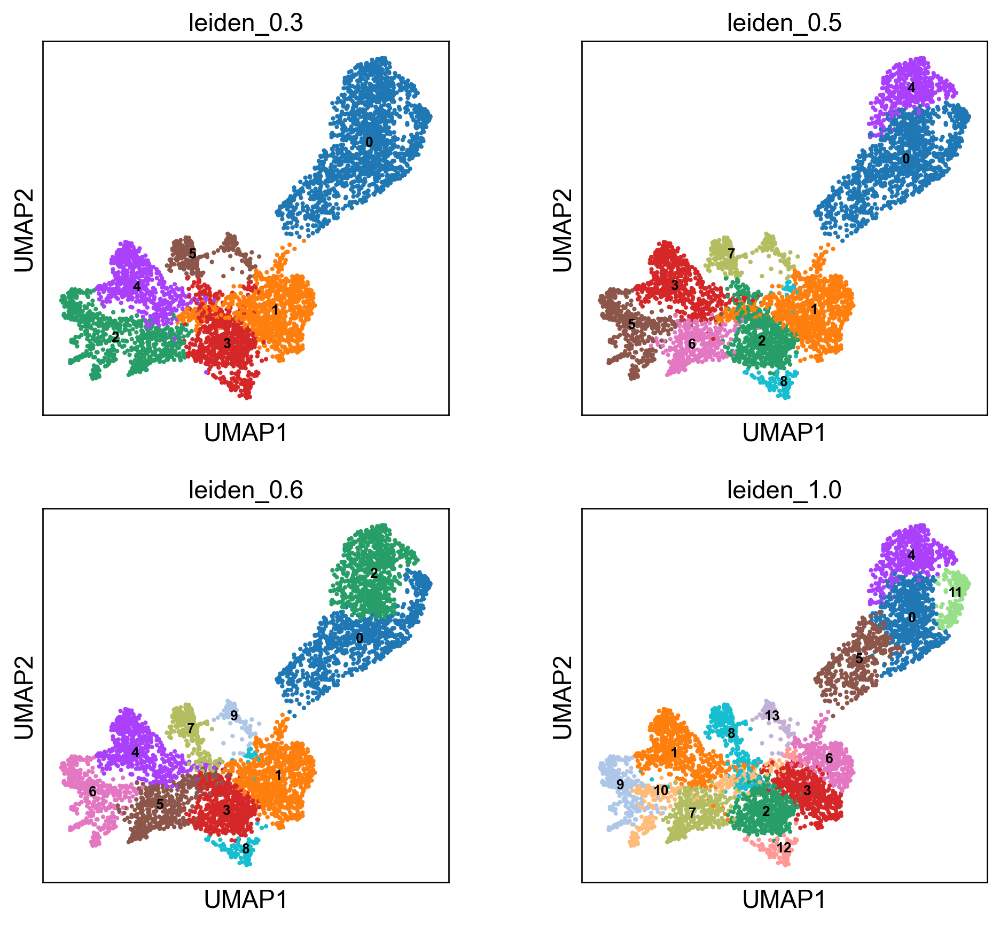

Saved → figures/clustering/umap_01_umap_resolutions.png


In [4]:
# UMAP — ALL RESOLUTIONS  
sc.pl.umap(
    adata,
    color=['leiden_0.3', 'leiden_0.5', 'leiden_0.6', 'leiden_1.0'],
    ncols=2,
    legend_loc='on data',
    legend_fontsize=8,
    save='_01_umap_resolutions.png'
)
print("Saved → figures/clustering/umap_01_umap_resolutions.png")

**Interpretation of spatial plots at different Leiden resolutions:**

- 0.3 is very coarse (big merged groups).
- 0.5 and 0.6 split the UMAP into more meaningful sub-islands without exploding into many tiny groups.
- 1.0 creates many smaller clusters (risk of over-splitting).

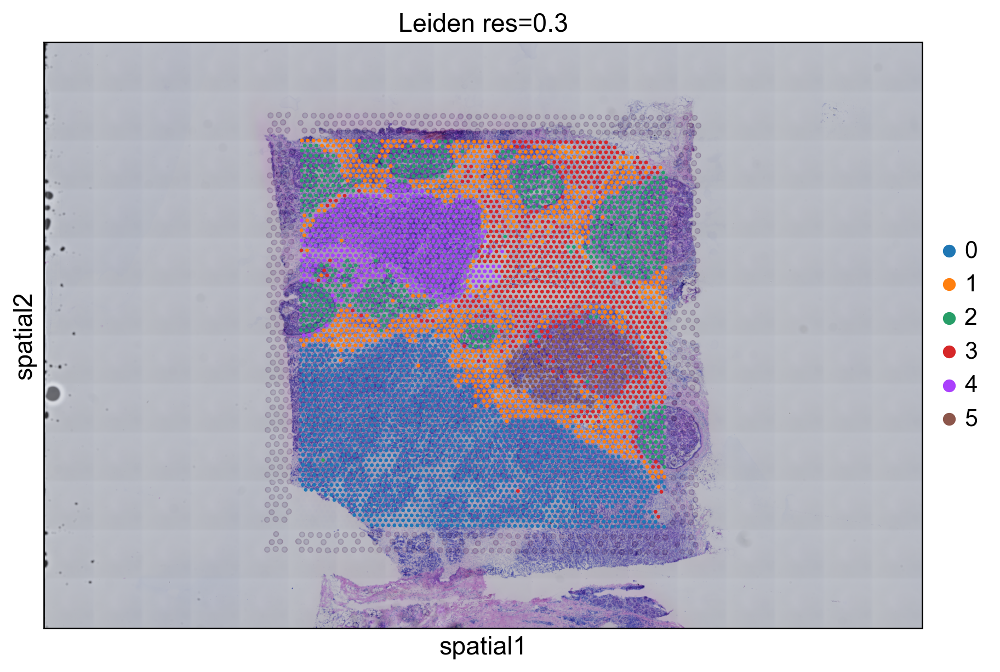

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\02_spatial_leiden_0.3.png


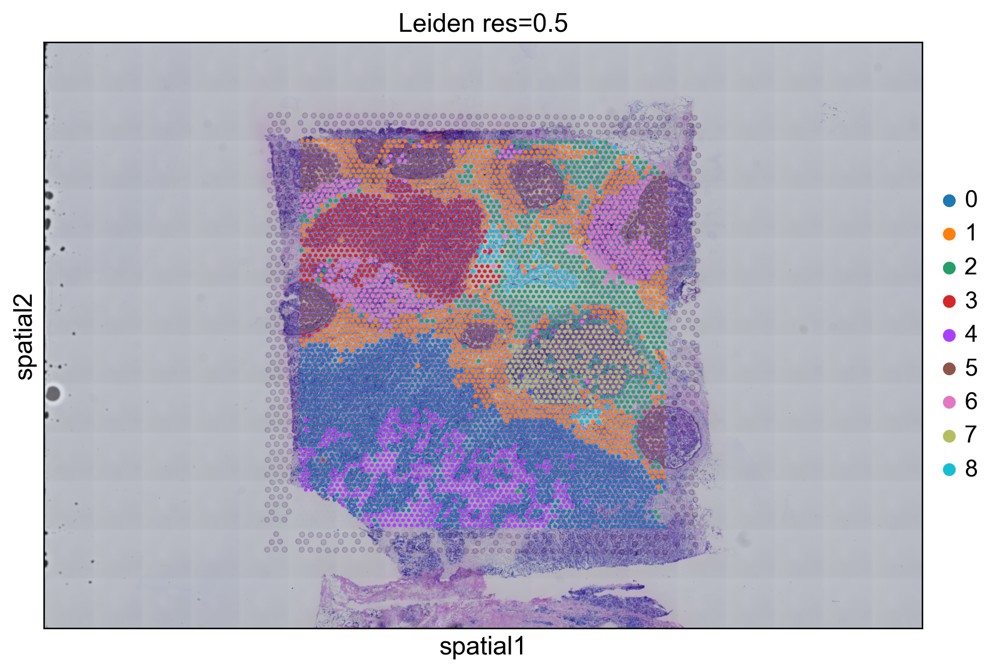

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\02_spatial_leiden_0.5.png


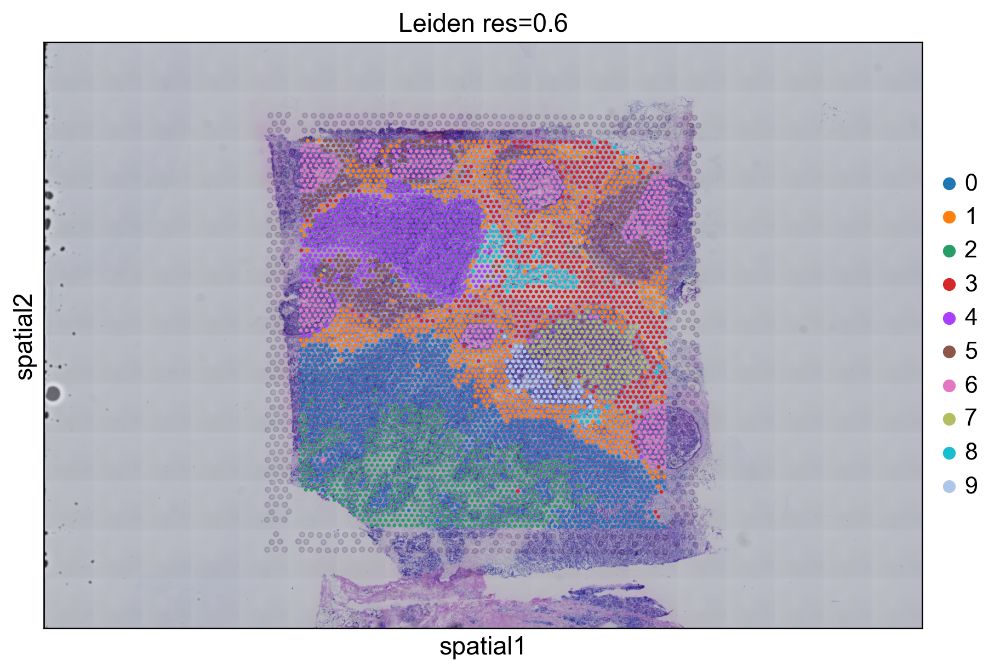

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\02_spatial_leiden_0.6.png


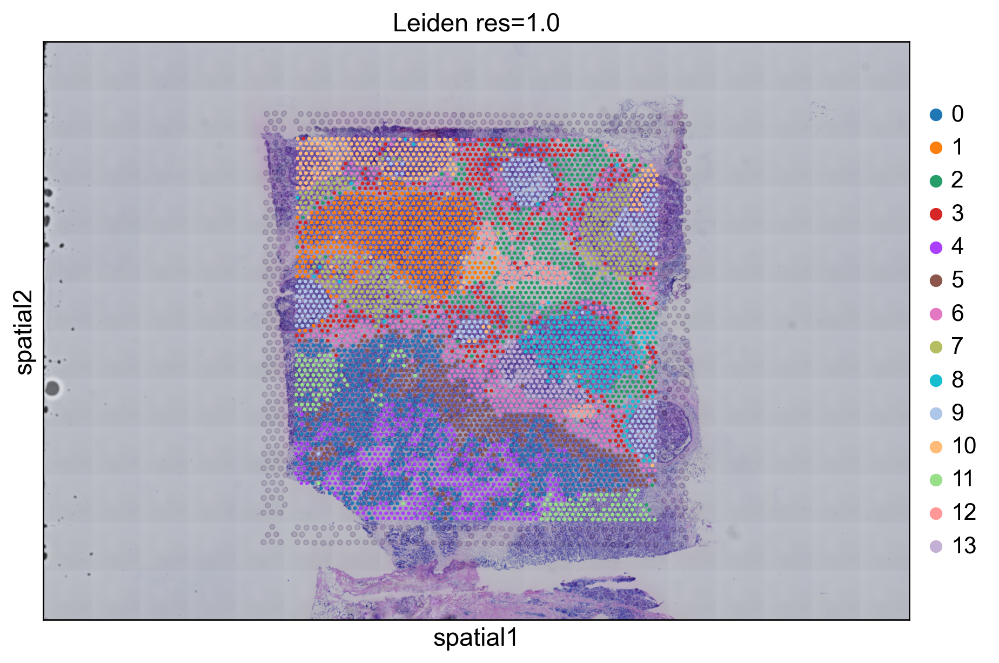

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\02_spatial_leiden_1.0.png


In [5]:
# SPATIAL SCATTER - CLUSTERS ON TISSUE
# Do clusters map to biological regions?

import matplotlib.pyplot as plt
from IPython.display import display

prev_figdir = sc.settings.figdir
sc.settings.figdir = str(fig_sp_dir)

for res in ['0.3', '0.5', '0.6', '1.0']:
    sq.pl.spatial_scatter(
        adata,
        color=f'leiden_{res}',
        title=f'Leiden res={res}',
        save=None,
    )

    fig = plt.gcf()
    fig.set_size_inches(14, 5)
    display(fig)

    out_path = fig_sp_dir / f'02_spatial_leiden_{res}.png'
    fig.savefig(out_path, dpi=200, facecolor='white', edgecolor='white', transparent=False, bbox_inches='tight')
    plt.close(fig)

    print(f'Saved -> {out_path}')

sc.settings.figdir = prev_figdir


**Interpretation of spatial plots at different Leiden resolutions:**

- **figures/spatial/02_spatial_leiden_0.3.png:**
  very clean big regions, but it’s a bit too coarse (likely merges multiple tissue programs).
- **figures/spatial/02_spatial_leiden_0.5.png:** 
  good balance—mostly contiguous domains with a few finer structures; not too “speckled”.
- **figures/spatial/02_spatial_leiden_0.6.png:** 
  starts to over-split some areas into smaller islands/patches (still usable, but more fragmentation).
- **figures/spatial/02_spatial_leiden_1.0.png:** 
  too fragmented/salt-and-pepper for domain-style interpretation.

In [6]:
# CHOOSE BEST RESOLUTION 
# After looking at the spatial plots above, pick the resolution
# that best matches tissue morphology (tumor vs stroma vs immune)

BEST_RES = 'leiden_0.5'   # updated after viewing spatial plots
adata.obs['leiden'] = adata.obs[BEST_RES].copy()

n_clusters = adata.obs['leiden'].nunique()
print(f"Working resolution : {BEST_RES}")
print(f"Number of clusters : {n_clusters}")
print(f"Cluster sizes:\n{adata.obs['leiden'].value_counts()}")

Working resolution : leiden_0.5
Number of clusters : 9
Cluster sizes:
leiden
0    1208
1     921
2     618
3     541
4     432
5     426
6     362
7     256
8     105
Name: count, dtype: int64


ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)
Marker genes computed


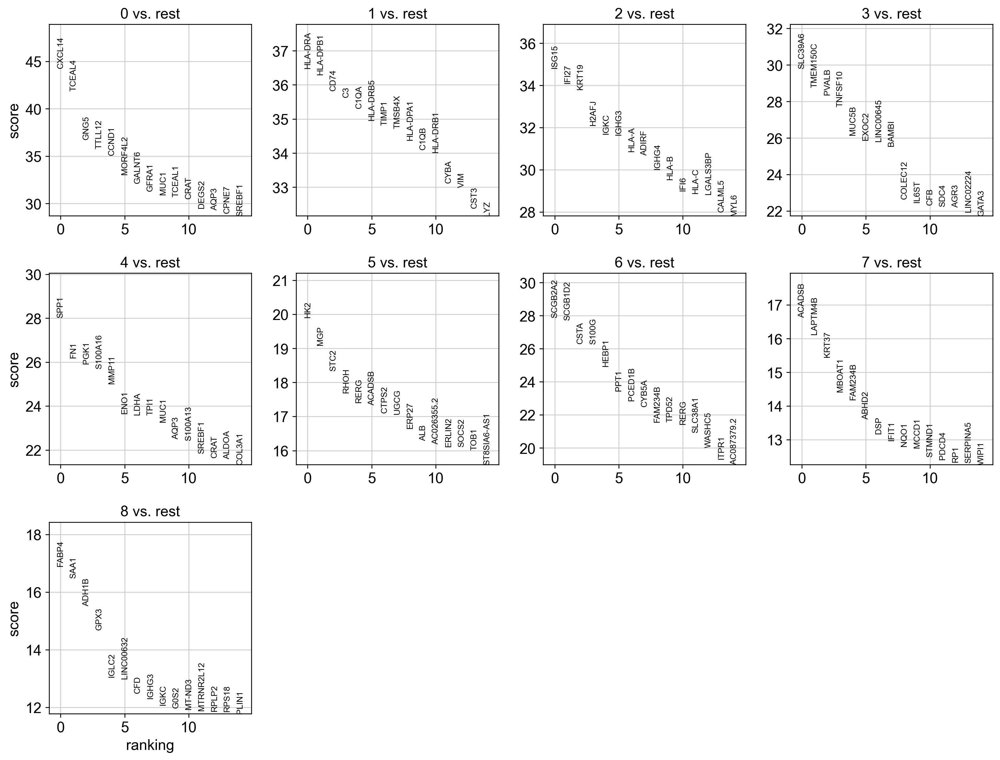

Saved figures/clustering/rank_genes_groups_03_marker_genes.png


In [7]:
# MARKER GENES PER CLUSTER
# Wilcoxon rank-sum test - robust for single-cell/spatial data

# Guard: ensure adata.obs['leiden'] exists (users often run cells out of order)
if 'leiden' not in adata.obs:
    # Prefer the chosen resolution if available
    if 'BEST_RES' in globals() and BEST_RES in adata.obs:
        adata.obs['leiden'] = adata.obs[BEST_RES].copy()
        print(f"Set adata.obs['leiden'] from {BEST_RES}")
    else:
        # Fall back to an existing leiden_* column
        candidates = [c for c in adata.obs.columns if c.startswith('leiden_')]
        if not candidates:
            raise RuntimeError('No Leiden labels found. Run the Leiden clustering step first.')
        preferred = 'leiden_0.5' if 'leiden_0.5' in candidates else sorted(candidates)[0]
        adata.obs['leiden'] = adata.obs[preferred].copy()
        print(f"Set adata.obs['leiden'] from {preferred}")

adata.obs['leiden'] = adata.obs['leiden'].astype('category')

sc.tl.rank_genes_groups(
    adata,
    groupby='leiden',
    method='wilcoxon',
    use_raw=True,
    pts=True,
)
print('Marker genes computed')

# Show top 15 markers per cluster
sc.pl.rank_genes_groups(
    adata,
    n_genes=15,
    sharey=False,
    save='_03_marker_genes.png',
)
print('Saved figures/clustering/rank_genes_groups_03_marker_genes.png')


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


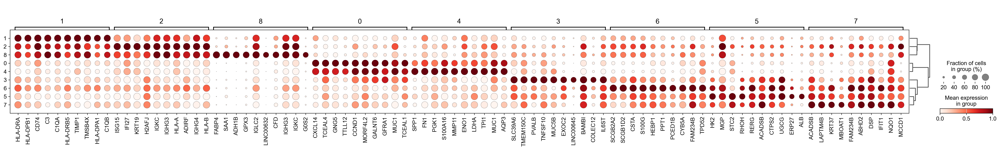

Saved figures/markers/dotplot_04_dotplot_markers.png


In [8]:
# DOTPLOT — TOP MARKERS
if "fig_mk_dir" not in globals():
    fig_mk_dir = project_root / "figures" / "markers"
    fig_mk_dir.mkdir(parents=True, exist_ok=True)

prev_figdir = sc.settings.figdir
sc.settings.figdir = str(fig_mk_dir)

sc.pl.rank_genes_groups_dotplot(
    adata,
    n_genes=10,
    standard_scale="var",
    save="_04_dotplot_markers.png",
)
print("Saved figures/markers/dotplot_04_dotplot_markers.png")
sc.settings.figdir = prev_figdir


Markers found in dataset: ['EPCAM', 'ESR1', 'ERBB2', 'KRT5', 'VIM', 'COL1A1', 'CD68', 'CD3D', 'MKI67', 'PECAM1']


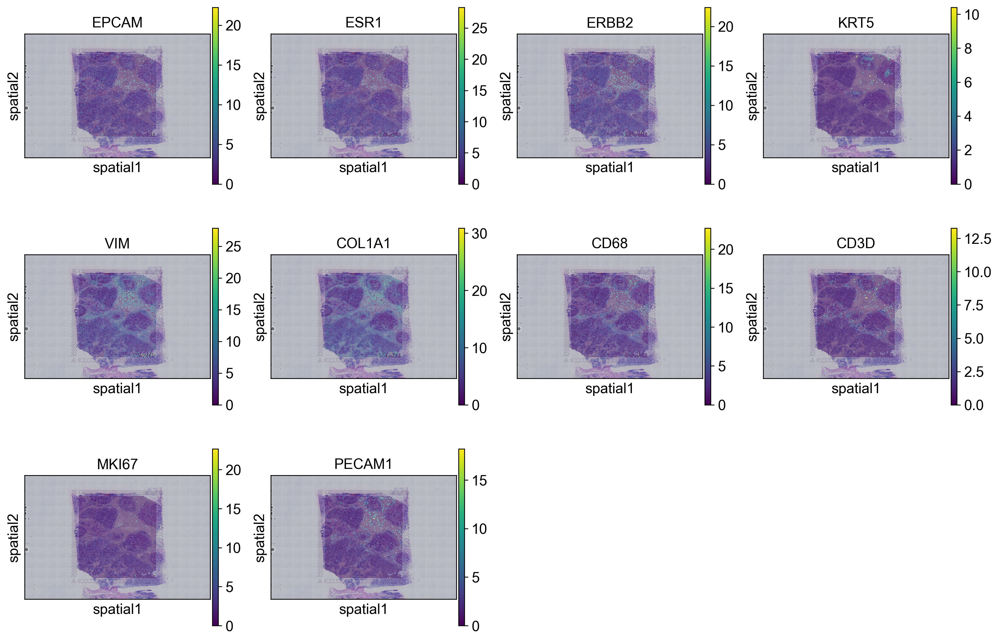

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\05_spatial_known_markers.png


In [9]:
# KNOWN BREAST CANCER MARKERS (SPATIAL)
# Visualize canonical markers on tissue to help annotate clusters

import matplotlib.pyplot as plt
from IPython.display import display

known_markers = [
    "EPCAM", "ESR1", "ERBB2", "KRT5", "VIM", "COL1A1",
    "CD68", "CD3D", "MKI67", "PECAM1",
]

markers_present = [g for g in known_markers if g in adata.var_names]
print(f"Markers found in dataset: {markers_present}")

if len(markers_present) == 0:
    raise RuntimeError("None of the known_markers were found in adata.var_names")

prev_figdir = sc.settings.figdir
sc.settings.figdir = str(fig_sp_dir)

sq.pl.spatial_scatter(
    adata,
    color=markers_present,
    ncols=4,
    use_raw=True,
    save=None,  # important: don't let squidpy save a transparent PNG
)

fig = plt.gcf()
fig.set_size_inches(16, 10)  # make it readable
display(fig)  # show in notebook

out_path = fig_sp_dir / "05_spatial_known_markers.png"
fig.savefig(out_path, dpi=200, facecolor="white", edgecolor="white", transparent=False, bbox_inches="tight")
plt.close(fig)

print(f"Saved -> {out_path}")

sc.settings.figdir = prev_figdir


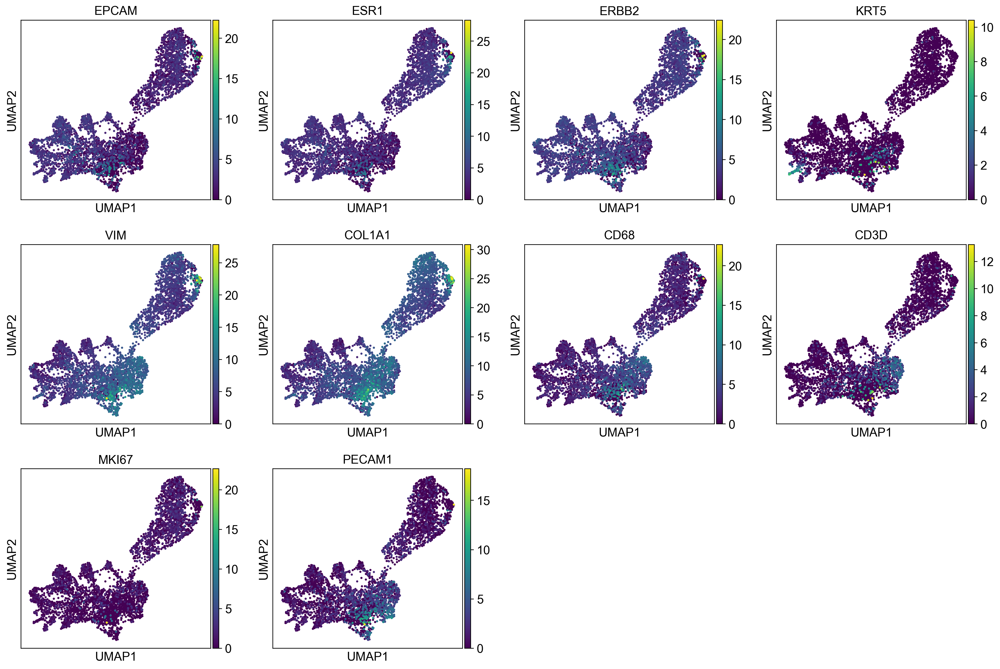

Saved figures/clustering/umap_06_umap_known_markers.png


In [10]:
# UMAP — KNOWN MARKERS 
sc.pl.umap(
    adata,
    color=markers_present,
    ncols=4,
    use_raw=True,
    save='_06_umap_known_markers.png'
)
print("Saved figures/clustering/umap_06_umap_known_markers.png")

In [11]:
# CELL : CLUSTER ANNOTATION 
# Based on marker gene spatial maps + dotplot results

cluster_labels = {
    '0': 'Fibrous Stroma (COL1A1+)',
    '1': 'Mixed Tumor-Stroma',
    '2': 'Stromal / CAF-rich',
    '3': 'Invasive Carcinoma Core (EPCAM+ ESR1+)',
    '4': 'Reactive Stroma (VIM+)',
    '5': 'Macrophage-rich (CD68+)',
    '6': 'Tumor-Stroma Interface',
    '7': 'Adipose / Normal epithelium',
    '8': 'Endothelial / Vascular (PECAM1+)',
}

adata.obs['cell_type'] = adata.obs['leiden'].map(cluster_labels)

print("Cluster annotations:")
for k, v in cluster_labels.items():
    n = (adata.obs['leiden'] == k).sum()
    print(f"  Cluster {k} ({n:4d} spots) → {v}")

Cluster annotations:
  Cluster 0 (1208 spots) → Fibrous Stroma (COL1A1+)
  Cluster 1 ( 921 spots) → Mixed Tumor-Stroma
  Cluster 2 ( 618 spots) → Stromal / CAF-rich
  Cluster 3 ( 541 spots) → Invasive Carcinoma Core (EPCAM+ ESR1+)
  Cluster 4 ( 432 spots) → Reactive Stroma (VIM+)
  Cluster 5 ( 426 spots) → Macrophage-rich (CD68+)
  Cluster 6 ( 362 spots) → Tumor-Stroma Interface
  Cluster 7 ( 256 spots) → Adipose / Normal epithelium
  Cluster 8 ( 105 spots) → Endothelial / Vascular (PECAM1+)


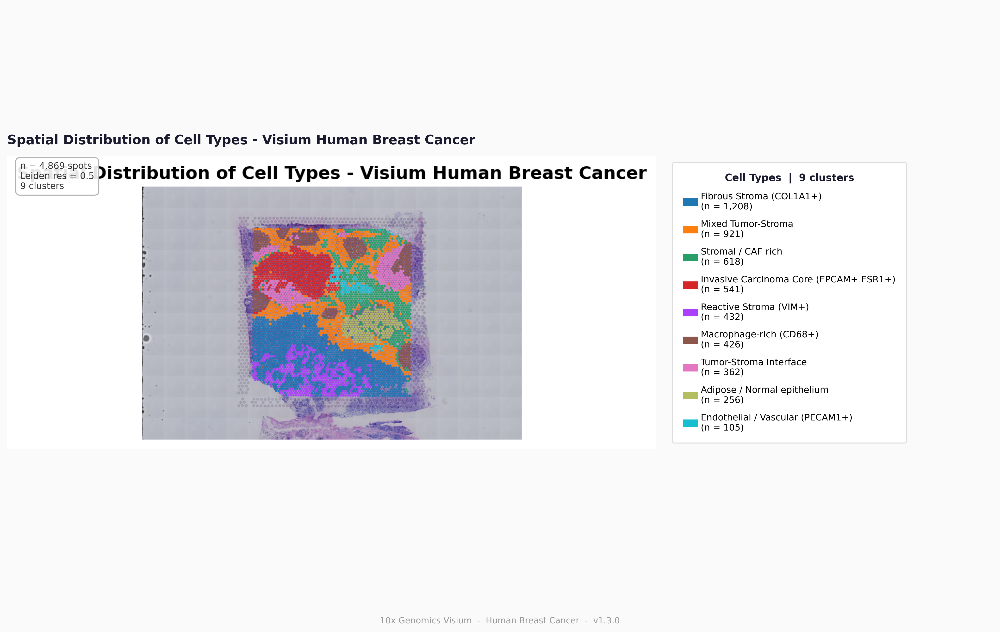

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\08_spatial_annotated_pub.png


In [ ]:
# SPATIAL PLOT WITH ANNOTATIONS
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib import rcParams
import numpy as np
from PIL import Image as PILImage

rcParams["font.family"] = "DejaVu Sans"
rcParams["font.size"] = 11
rcParams["axes.titlesize"] = 13
rcParams["axes.titleweight"] = "bold"

# Ensure categorical + colors exist
if not hasattr(adata.obs["cell_type"], "cat"):
    adata.obs["cell_type"] = adata.obs["cell_type"].astype("category")
if "cell_type_colors" not in adata.uns:
    sc.pl.umap(adata, color="cell_type", show=False)  # generates colors

cluster_counts = adata.obs["cell_type"].value_counts().to_dict()
n_types = len(cluster_counts)

palette = dict(
    zip(
        adata.obs["cell_type"].cat.categories,
        adata.uns["cell_type_colors"],
    )
)

# Step 1: Base figure, then save it
prev_figdir = sc.settings.figdir
sc.settings.figdir = str(fig_sp_dir)

sq.pl.spatial_scatter(
    adata,
    color="cell_type",
    size=1.4,
    legend_loc=None,
    frameon=False,
    title="Spatial Distribution of Cell Types - Visium Human Breast Cancer",
    save=None,
)

fig = plt.gcf()
base_path = fig_sp_dir / "08_spatial_annotated_base.png"
fig.savefig(
    base_path,
    dpi=200,
    facecolor="white",
    edgecolor="white",
    transparent=False,
    bbox_inches="tight",
)
plt.close(fig)

sc.settings.figdir = prev_figdir

# Reload that saved image and redraw 
base_img = PILImage.open(base_path)

fig, axes = plt.subplots(
    1,
    2,
    figsize=(14, 9),
    dpi=150,
    gridspec_kw={"width_ratios": [2, 1]},
)
fig.patch.set_facecolor("#FAFAFA")

# Left: tissue image
axes[0].imshow(np.array(base_img))
axes[0].axis("off")
axes[0].set_title(
    "Spatial Distribution of Cell Types - Visium Human Breast Cancer",
    fontsize=13,
    fontweight="bold",
    loc="left",
    pad=12,
    color="#1a1a2e",
)

# Stats box on image
textstr = f"n = {adata.n_obs:,} spots\nLeiden res = 0.5\n{n_types} clusters"
props = dict(boxstyle="round,pad=0.5", facecolor="white", edgecolor="#aaaaaa", alpha=0.9)
axes[0].text(
    0.02,
    0.98,
    textstr,
    transform=axes[0].transAxes,
    fontsize=9,
    verticalalignment="top",
    bbox=props,
    color="#333333",
)

# Right: legend panel as colored table
patches = [
    mpatches.Patch(
        color=palette[ct],
        label=f"{ct}\n(n = {cluster_counts.get(ct, 0):,})",
    )
    for ct in adata.obs["cell_type"].cat.categories
]

axes[1].set_facecolor("#FAFAFA")
axes[1].axis("off")

legend = axes[1].legend(
    handles=patches,
    title=f"Cell Types  |  {n_types} clusters",
    title_fontsize=10,
    fontsize=9,
    loc="center left",
    frameon=True,
    framealpha=1.0,
    edgecolor="#dddddd",
    facecolor="white",
    borderpad=1.2,
    labelspacing=1.0,
    handlelength=1.5,
)
legend.get_title().set_fontweight("bold")
legend.get_title().set_color("#1a1a2e")

fig.suptitle(
    "10x Genomics Visium  -  Human Breast Cancer  -  v1.3.0",
    fontsize=8.5,
    color="#999999",
    y=0.01,
)

plt.tight_layout(rect=[0, 0.02, 1, 1])
out = fig_sp_dir / "08_spatial_annotated_pub.png"
plt.savefig(out, dpi=200, bbox_inches="tight", facecolor="#FAFAFA")
plt.show()
print(f"Saved -> {out}")


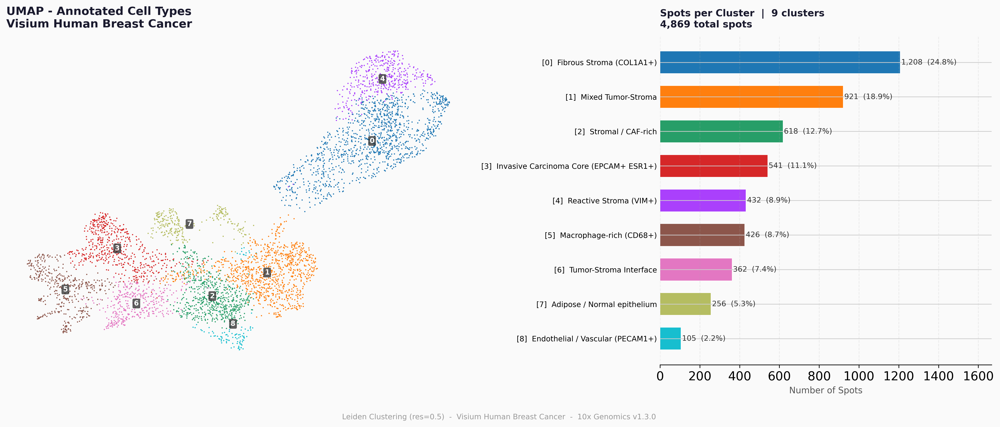

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\clustering\07_umap_annotated_pub.png


In [ ]:
# UMAP WITH ANNOTATIONS 
import matplotlib.pyplot as plt
from matplotlib import rcParams
import numpy as np

rcParams["font.family"] = "DejaVu Sans"
rcParams["font.size"] = 11
rcParams["axes.titlesize"] = 13
rcParams["axes.titleweight"] = "bold"

# ---- Guards / prerequisites ----
if "cell_type" not in adata.obs:
    raise RuntimeError("Missing adata.obs['cell_type'] - run the annotation step first.")

if not hasattr(adata.obs["cell_type"], "cat"):
    adata.obs["cell_type"] = adata.obs["cell_type"].astype("category")

if "cell_type_colors" not in adata.uns:
    sc.pl.umap(adata, color="cell_type", show=False)  # generates colors

if "cluster_labels" not in globals():
    raise RuntimeError("Missing `cluster_labels` dict - run the cell where you define cluster_labels.")

n_types = adata.obs["cell_type"].nunique()

palette = dict(
    zip(
        adata.obs["cell_type"].cat.categories,
        adata.uns["cell_type_colors"],
    )
)

# Map cell_type string -> cluster id (safe, avoids IndexError)
label_by_ct = {v: k for k, v in cluster_labels.items()}

# ── Step 1: scanpy UMAP works fine with ax= directly ─────
fig, axes = plt.subplots(
    1, 2, figsize=(16, 7), dpi=150,
    gridspec_kw={"width_ratios": [1.4, 1]},
)
fig.patch.set_facecolor("#FAFAFA")

# LEFT: UMAP
sc.pl.umap(
    adata,
    color="cell_type",
    ax=axes[0],
    title="",
    legend_loc=None,
    frameon=False,
    show=False,
    size=8,
)

axes[0].set_title(
    "UMAP - Annotated Cell Types\nVisium Human Breast Cancer",
    fontsize=13, fontweight="bold",
    loc="left", color="#1a1a2e", pad=10,
)
axes[0].set_xlabel("UMAP 1", fontsize=10, color="#555")
axes[0].set_ylabel("UMAP 2", fontsize=10, color="#555")
axes[0].set_facecolor("#FAFAFA")

# Cluster number labels on centroids
for ct in adata.obs["cell_type"].cat.categories:
    mask = adata.obs["cell_type"] == ct
    coords = adata.obsm["X_umap"][mask.values]
    if coords.shape[0] == 0:
        continue
    cx = coords[:, 0].mean()
    cy = coords[:, 1].mean()
    label = label_by_ct.get(ct, "")
    axes[0].text(
        cx, cy, label,
        fontsize=8, fontweight="bold",
        ha="center", va="center", color="white",
        bbox=dict(
            boxstyle="round,pad=0.2",
            facecolor="#222222",
            edgecolor="none",
            alpha=0.72,
        ),
    )

# RIGHT: Horizontal bar chart — spots per cluster
counts = adata.obs["cell_type"].value_counts().sort_values(ascending=True)
colors = [palette[ct] for ct in counts.index]

axes[1].barh(
    range(len(counts)),
    counts.values,
    color=colors,
    edgecolor="white",
    linewidth=0.5,
    height=0.65,
)

# Value labels
for i, val in enumerate(counts.values):
    axes[1].text(
        val + 5, i,
        f"{val:,}  ({val / adata.n_obs * 100:.1f}%)",
        va="center", fontsize=8.5, color="#333333",
    )

# Y tick labels with cluster number and annotation
axes[1].set_yticks(range(len(counts)))
axes[1].set_yticklabels(
    [f"[{label_by_ct.get(ct, '?')}]  {ct}" for ct in counts.index],
    fontsize=8.5,
)

axes[1].set_xlabel("Number of Spots", fontsize=10, color="#555")
axes[1].set_title(
    f"Spots per Cluster  |  {n_types} clusters\n{adata.n_obs:,} total spots",
    fontsize=11, fontweight="bold",
    loc="left", color="#1a1a2e", pad=10,
)
axes[1].set_xlim(0, counts.max() * 1.38)
axes[1].set_facecolor("#FAFAFA")
axes[1].spines["top"].set_visible(False)
axes[1].spines["right"].set_visible(False)
axes[1].spines["left"].set_visible(False)
axes[1].tick_params(axis="y", length=0)
axes[1].grid(axis="x", alpha=0.2, linestyle="--", color="#aaaaaa")

fig.suptitle(
    "Leiden Clustering (res=0.5)  -  Visium Human Breast Cancer  -  10x Genomics v1.3.0",
    fontsize=8.5, color="#999999", y=0.01,
)

plt.tight_layout(rect=[0, 0.03, 1, 1])
from pathlib import Path

if "fig_cl_dir" not in globals():
    fig_cl_dir = project_root / "figures" / "clustering"
    fig_cl_dir.mkdir(parents=True, exist_ok=True)

out = fig_cl_dir / "07_umap_annotated_pub.png"
plt.savefig(out, dpi=200, bbox_inches="tight", facecolor="#FAFAFA")
plt.show()
print(f"Saved -> {out}")


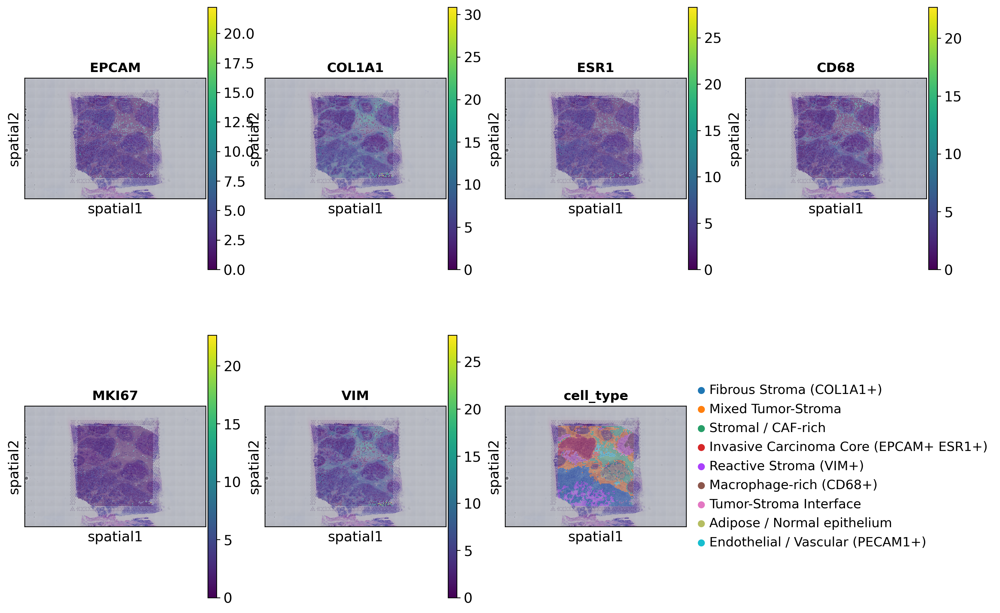

Saved -> C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\figures\spatial\09_spatial_summary_panel.png


In [20]:
# SPATIAL - KEY MARKER PAIRS
# Compare tumor marker vs stromal marker side by side

import matplotlib.pyplot as plt
from IPython.display import display

prev_figdir = sc.settings.figdir
sc.settings.figdir = str(fig_sp_dir)

sq.pl.spatial_scatter(
    adata,
    color=['EPCAM', 'COL1A1', 'ESR1', 'CD68', 'MKI67', 'VIM', 'cell_type'],
    ncols=4,
    use_raw=True,
    save=None,
)

fig = plt.gcf()
fig.set_size_inches(16, 10)
display(fig)

out_path = fig_sp_dir / '09_spatial_summary_panel.png'
fig.savefig(out_path, dpi=200, facecolor='white', edgecolor='white', transparent=False, bbox_inches='tight')
plt.close(fig)

sc.settings.figdir = prev_figdir
print(f'Saved -> {out_path}')


In [21]:
# SAVE ANNOTATED ADATA 
out_path = processed_dir / 'adata_annotated.h5ad'
adata.write_h5ad(out_path)

print(f"✅ Saved → {out_path}")
print(f"   Shape : {adata.n_obs:,} spots × {adata.n_vars:,} genes")

print('\n' + '=' * 55)
print('  NOTEBOOK 03 — CLUSTERING COMPLETE')
print('=' * 55)
print(f'  Clusters         : 9 (leiden_0.5)')
print(f'  Annotation       : adata.obs["cell_type"]')
print(f'  Key finding      : ESR1+ ER-positive luminal tumor')
print(f'  Tumor marker     : EPCAM, ESR1, ERBB2, MKI67')
print(f'  Stroma marker    : COL1A1, VIM')
print(f'  Immune marker    : CD68 (macrophages), CD3D (T cells)')
print(f'  Saved to         : data/processed/adata_annotated.h5ad')
print('=' * 55)
print('\n→ Next: 04_Spatial_Analysis.ipynb')

✅ Saved → C:\Users\mmsid\Documents\github\My Project\spatial_biology_project\data\processed\adata_annotated.h5ad
   Shape : 4,869 spots × 21,349 genes

  NOTEBOOK 03 — CLUSTERING COMPLETE
  Clusters         : 9 (leiden_0.5)
  Annotation       : adata.obs["cell_type"]
  Key finding      : ESR1+ ER-positive luminal tumor
  Tumor marker     : EPCAM, ESR1, ERBB2, MKI67
  Stroma marker    : COL1A1, VIM
  Immune marker    : CD68 (macrophages), CD3D (T cells)
  Saved to         : data/processed/adata_annotated.h5ad

→ Next: 04_Spatial_Analysis.ipynb
